# Introduction

In my previous notebook, I used a python script to save locally all my travel pictures (URLs collected from Pexels API). Then, I tested VGG16 on a sample of 35 images (I have 3600+ pictures). It worked. The purpose is now to deploy clustering for all the dataset. And finally, I will also explore other clustering techniques without VGG16.


## Importing Libraries

In [46]:
# Importing Libraries
import requests
import pandas as pd
import time
import json
import re
from sqlalchemy import create_engine
import pymysql.cursors
import os
import getpass
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from stop_words import get_stop_words
from PIL import Image

import urllib.request
import os

# Extending display
pd.set_option('display.max_colwidth', 5000)
pd.set_option('display.max_rows', 5000)

# for loading/processing the images  
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing.image import img_to_array
from keras.applications.vgg16 import preprocess_input 

# for scaling
from sklearn.preprocessing import StandardScaler

# models 
from keras.applications.vgg16 import VGG16 
from keras.models import Model

# clustering and dimension reduction
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

# for everything else
import os
import numpy as np
import matplotlib.pyplot as plt
from random import randint
import pandas as pd
import pickle
import random
from IPython.display import Image


## Loading my dataset

In [3]:
main_data = pd.read_csv("C:/Users/monkeyluffy14/Desktop/Final Project/main_merged.csv")

In [4]:
main_data.head()

,Pictures_id,Width,Height,Full URL,Photographer_id,Description,Country_id,Country_name,region,sub-region,Hex,R,G,B,Photographer
0,13918727,5304,7952,https://www.pexels.com/photo/sculpture-and-streetlight-near-eiffel-tower-in-paris-france-13918727/,5767088,black statue of man on top of building,1,France,Europe,Western Europe,#5E5141,94,81,65,eugenia remark
1,14918481,2000,2500,https://www.pexels.com/photo/photo-of-a-mont-san-michele-abbey-in-france-14918481/,406314056,photo of a mont san michele abbey in france,1,France,Europe,Western Europe,#6C635C,108,99,92,paul jousseau
2,15308877,3629,2433,https://www.pexels.com/photo/concrete-building-view-from-balcony-15308877/,956039,concrete building view from balcony,1,France,Europe,Western Europe,#7B7B79,123,123,121,jill evans
3,14544821,2432,3636,https://www.pexels.com/photo/eiffel-tower-and-seine-14544821/,1245209,eiffel tower and seine,1,France,Europe,Western Europe,#979CA2,151,156,162,polina chistyakova
4,2363,1600,1066,https://www.pexels.com/photo/clear-glass-museum-during-golden-hour-2363/,2659,clear glass museum during golden hour,1,France,Europe,Western Europe,#8E5F38,142,95,56,pixabay


In [5]:
main_data.shape

(3682, 15)

# VGG16 applied to 3k2 pictures

In [162]:
# I define a path where all my images are stored (download from a previous script)
path = r"C:/Users/monkeyluffy14/Desktop/Final Project/images"

# change the working directory to the path where the images are located
os.chdir(path)

# this list holds all the image filename
pictures = []

# creates a ScandirIterator aliased as files
with os.scandir(path) as files:
  # loops through each file in the directory
    for file in files:
        if file.name.endswith('.jpg'):
          # adds only the image files to the pictures list
            pictures.append(file.name)

In [76]:
len(pictures)

3682

In [145]:
# Using VGG16, a pre-trained image recognition model, as starting point
model = VGG16()

# I am creating a new Model that takes the same inputs as the VGG16 model (an image with shape (224, 224, 3))
# As outputs, I will have the activations of the second-to-last layer of the VGG16 model
# I don't take the last layer because it's usually the results of their classification study (not relevant for me)
# The output will be: a 4096-dimensional vector from each picture
model = Model(inputs = model.inputs, outputs = model.layers[-2].output)

In [144]:
# defining a function to extract pictures'features 

def extract_features(file, model):
    # load the image as a 224x224 array, as mentioned above, it's a pre-requisiste from VGG16
    # having all images loaded in same size also make them more "comparable"
    img = load_img(file, target_size=(224,224))
    # convert from 'PIL.Image.Image' to numpy array
    img = np.array(img) 
    # reshape the data for the model reshape(num_of_samples, dim 1, dim 2, channels RGB)
    reshaped_img = img.reshape(1,224,224,3) 
    # prepare image for model
    # applying the same preprocessing steps used during training of the pre-trained CNN model
    imgx = preprocess_input(reshaped_img)
    # get the feature vector
    features = model.predict(imgx, use_multiprocessing=True)
    return features

In [27]:
data = {}

# lop through each image in the dataset
# pictures have been defined before as a list of all my pictures'name/title
for picture in pictures:
    # try to extract the features and update the dictionary
    try:
        features = extract_features(picture,model)
        data[picture] = features
    # if something fails, save the extracted features as a pickle file (optional)
    except:
        with open(p,'wb') as file:
            pickle.dump(data,file)

1/1 [==============================] - 0s 183ms/step


C:\Users\monkeyluffy14\anaconda3\lib\site-packages\PIL\Image.py:959: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


1/1 [==============================] - 0s 160ms/step


1/1 [==============================] - 0s 162ms/step


1/1 [==============================] - 0s 163ms/step


1/1 [==============================] - 0s 174ms/step


1/1 [==============================] - 0s 198ms/step


1/1 [==============================] - 0s 178ms/step


1/1 [==============================] - 0s 207ms/step


1/1 [==============================] - 0s 208ms/step


1/1 [==============================] - 0s 166ms/step


1/1 [==============================] - 0s 231ms/step


1/1 [==============================] - 0s 217ms/step


1/1 [==============================] - 0s 252ms/step


In [93]:
data = load("C:/Users/monkeyluffy14/Desktop/Final Project/data.pickle")

In [94]:
# Following the previous step, data is now a dict. with keys: pictures file name and values: features extracted from the model
len(list(data.keys()))

3682

In [95]:
# get a list of just the features
# we have 3682 images and each images is associated with a vector of 4096 dimensions
list_features = np.array(list(data.values()))
list_features.shape

(3682, 1, 4096)

In [12]:
# but the we need to remove the "1" 
# reshape so that there are 3682 images of 4096 vectors
feat = list_features.reshape(-1,4096)
feat.shape

(3682, 4096)

## Saving features as pickle and df 

In [60]:
# Convert the dictionary into a list of tuples
data_list = [(k,) + tuple(v.flatten()) for k, v in data.items()]

# Create a dataframe from the list of tuples
df = pd.DataFrame(data_list, columns=['filename'] + ['feat_dim_' + str(i) for i in range(4096)])

In [94]:
df.head()

,filename,feat_dim_0,feat_dim_1,feat_dim_2,feat_dim_3,feat_dim_4,feat_dim_5,feat_dim_6,feat_dim_7,feat_dim_8,...,feat_dim_4086,feat_dim_4087,feat_dim_4088,feat_dim_4089,feat_dim_4090,feat_dim_4091,feat_dim_4092,feat_dim_4093,feat_dim_4094,feat_dim_4095
0,10012539.jpg,2.154394,3.488796,0.378023,0.000000,2.770923,0.000000,0.000000,0.000000,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.714101,4.315653,0.000000,0.0
1,10012541.jpg,4.448317,0.987673,0.798184,0.000000,3.815212,0.485837,0.708865,0.000000,0.0,...,0.000000,0.000000,1.660602,0.000000,0.510503,1.577370,0.000000,0.000000,2.403101,0.0
2,10018321.jpg,0.532529,0.000000,0.000000,0.682105,4.304263,1.469426,0.008053,0.000000,0.0,...,3.353007,0.924973,2.405357,0.000000,0.000000,0.000000,0.000000,2.449385,0.000000,0.0
3,1002525.jpg,0.000000,1.050110,0.000000,0.257583,0.000000,0.000000,0.000000,0.000000,0.0,...,0.000000,0.000000,0.000000,0.348582,0.000000,0.286617,1.213917,0.345944,1.664520,0.0
4,1002541.jpg,0.823804,1.473179,0.000000,0.761092,3.981729,0.000000,0.000000,0.297042,0.0,...,0.779526,0.000000,3.868098,0.000000,0.000000,3.066732,0.000000,1.192088,0.758184,0.0


In [70]:
df.to_csv("filename_features.csv")

In [13]:
feat

array([[2.1543944 , 3.488796  , 0.3780234 , ..., 4.3156533 , 0.        ,
        0.        ],
       [4.448317  , 0.98767257, 0.7981844 , ..., 0.        , 2.4031014 ,
        0.        ],
       [0.5325289 , 0.        , 0.        , ..., 2.4493847 , 0.        ,
        0.        ],
       ...,
       [0.6471275 , 3.4932659 , 0.8316668 , ..., 0.        , 1.0739937 ,
        0.        ],
       [0.        , 0.942093  , 0.        , ..., 0.17221785, 0.        ,
        1.02824   ],
       [0.        , 1.8326648 , 0.        , ..., 0.34992307, 0.        ,
        0.        ]], dtype=float32)

In [76]:
with open('features.pickle', 'wb') as f:
    pickle.dump(feat, f)

In [78]:
os.chdir("C:/Users/monkeyluffy14/Desktop/Final Project")

# Load the pickle file
with open('features.pickle', 'rb') as f:
    my_data = pickle.load(f)

# Do something with my_data
print(my_data)

[[2.1543944  3.488796   0.3780234  ... 4.3156533  0.         0.        ]
 [4.448317   0.98767257 0.7981844  ... 0.         2.4031014  0.        ]
 [0.5325289  0.         0.         ... 2.4493847  0.         0.        ]
 ...
 [0.6471275  3.4932659  0.8316668  ... 0.         1.0739937  0.        ]
 [0.         0.942093   0.         ... 0.17221785 0.         1.02824   ]
 [0.         1.8326648  0.         ... 0.34992307 0.         0.        ]]


In [186]:
with open('data.pickle', 'wb') as f:
    pickle.dump(data, f)

In [110]:
df.describe()

,feat_dim_0,feat_dim_1,feat_dim_2,feat_dim_3,feat_dim_4,feat_dim_5,feat_dim_6,feat_dim_7,feat_dim_8,feat_dim_9,...,feat_dim_4086,feat_dim_4087,feat_dim_4088,feat_dim_4089,feat_dim_4090,feat_dim_4091,feat_dim_4092,feat_dim_4093,feat_dim_4094,feat_dim_4095
count,3682.000000,3682.000000,3682.000000,3682.000000,3682.000000,3682.000000,3682.000000,3682.000000,3682.000000,3682.000000,...,3682.000000,3682.000000,3682.000000,3682.000000,3682.000000,3682.000000,3682.000000,3682.000000,3682.000000,3682.000000
mean,0.738914,1.646757,0.565079,0.543735,2.152962,0.603487,0.754847,0.639051,0.111268,0.388823,...,0.426883,0.545960,0.916421,0.188805,0.151494,1.063553,1.102632,1.069165,0.754771,0.125771
std,1.208904,1.918576,0.998614,1.023797,1.996238,1.088887,1.275980,1.327878,0.464674,0.918284,...,1.030844,1.051335,1.492911,0.595183,0.582349,1.484927,1.449371,1.552991,1.163042,0.474275
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.193679,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,1.056365,0.000000,0.000000,1.842282,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.182935,0.395648,0.213895,0.000000,0.000000
75%,1.160156,2.766998,0.830927,0.741302,3.424502,0.815661,1.158672,0.627866,0.000000,0.202912,...,0.218004,0.699676,1.366091,0.000000,0.000000,1.833761,1.886265,1.739180,1.227413,0.000000
max,11.678430,14.388982,9.299255,9.252308,13.626276,8.423965,14.187494,10.096940,6.960113,9.266890,...,12.328231,9.356132,11.304822,8.761259,9.474246,7.902999,8.567234,11.511124,7.971196,5.938041


## Scaling my data & Saving Scaler pickle

In [111]:
# Standardize the features
scaler = StandardScaler()
scaled_feat = scaler.fit_transform(feat)

In [113]:
# Saving the scalar
with open("scaler.pickle", "wb") as f:
    pickle.dump(scaler,f)

In [6]:
def load(filename): 
    try: 
        with open(filename, "rb") as f: 
            return pickle.load(f) 
        
    except FileNotFoundError: 
        print("File not found!") 

In [7]:
# comparing with df describe above, it's correctly saving the same means
load("scaler.pickle").mean_

array([0.73891427, 1.64675491, 0.56507927, ..., 1.06916358, 0.75477111,
       0.12577132])

In [8]:
# and same std, all good!
load("scaler.pickle").scale_

array([1.20875054, 1.91830753, 0.99847356, ..., 1.55277902, 1.16288709,
       0.47421594])

## PCA

### Determining the # of components to keep ?

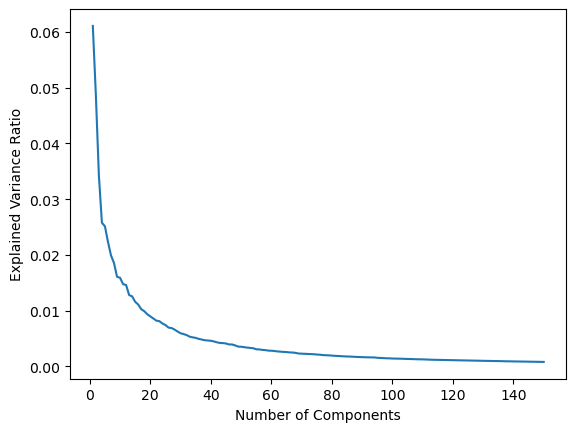

In [117]:
pca = PCA(n_components=150, random_state=22)

# The purpose of fitting a PCA model to a dataset is to find the principal components, 
# which are new dimensions that capture most of the variance in the original dataset.
pca.fit(feat)

plt.plot(range(1, 151), pca.explained_variance_ratio_)
plt.xlabel('Number of Components')
plt.ylabel('Explained Variance Ratio')
plt.show()

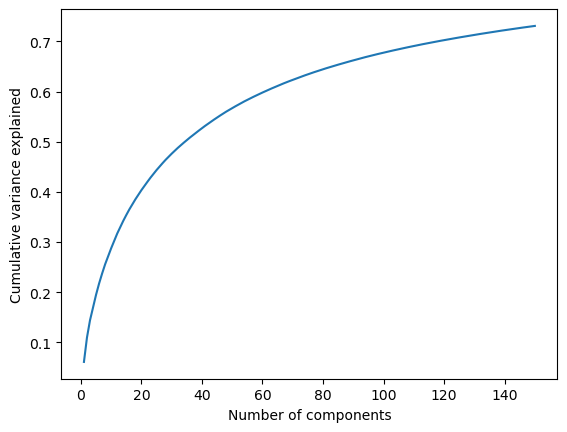

In [118]:
# get the explained variance ratios
explained_var_ratio = pca.explained_variance_ratio_

# get the cumulative sum of the explained variance ratios
cumulative_var_ratio = np.cumsum(explained_var_ratio)

# plot the cumulative variance explained against number of components
plt.plot(range(1, len(cumulative_var_ratio)+1), cumulative_var_ratio)
plt.xlabel('Number of components')
plt.ylabel('Cumulative variance explained')
plt.show()

In [119]:
n_components_70percent = np.argmax(cumulative_var_ratio >= 0.7) + 1
print("Number of components to reach 70% variance:", n_components_70percent)

Number of components to reach 70% variance: 118


### Saving PCA (down to 120 components)

In [120]:
pca = PCA(n_components=120, random_state=22)
pca.fit(scaled_feat)
x = pca.transform(scaled_feat)

In [122]:
x.shape

(3682, 120)

In [123]:
# Save PCA object to a pickle file
with open('pca_model.pkl', 'wb') as f:
    pickle.dump(pca, f)

# Kmeans

## Choosing number of clusters k

Training a K-Means model with 2 clusters! 

Training a K-Means model with 3 clusters! 

Training a K-Means model with 4 clusters! 

Training a K-Means model with 5 clusters! 

Training a K-Means model with 6 clusters! 

Training a K-Means model with 7 clusters! 

Training a K-Means model with 8 clusters! 

Training a K-Means model with 9 clusters! 

Training a K-Means model with 10 clusters! 

Training a K-Means model with 11 clusters! 

Training a K-Means model with 12 clusters! 

Training a K-Means model with 13 clusters! 

Training a K-Means model with 14 clusters! 

Training a K-Means model with 15 clusters! 

Training a K-Means model with 16 clusters! 

Training a K-Means model with 17 clusters! 

Training a K-Means model with 18 clusters! 

Training a K-Means model with 19 clusters! 

Training a K-Means model with 20 clusters! 

Training a K-Means model with 21 clusters! 

Training a K-Means model with 22 clusters! 

Training a K-Means model with 23 clusters! 

Training a K-Means

Text(0.5, 1.0, 'Elbow Method showing the optimal k')

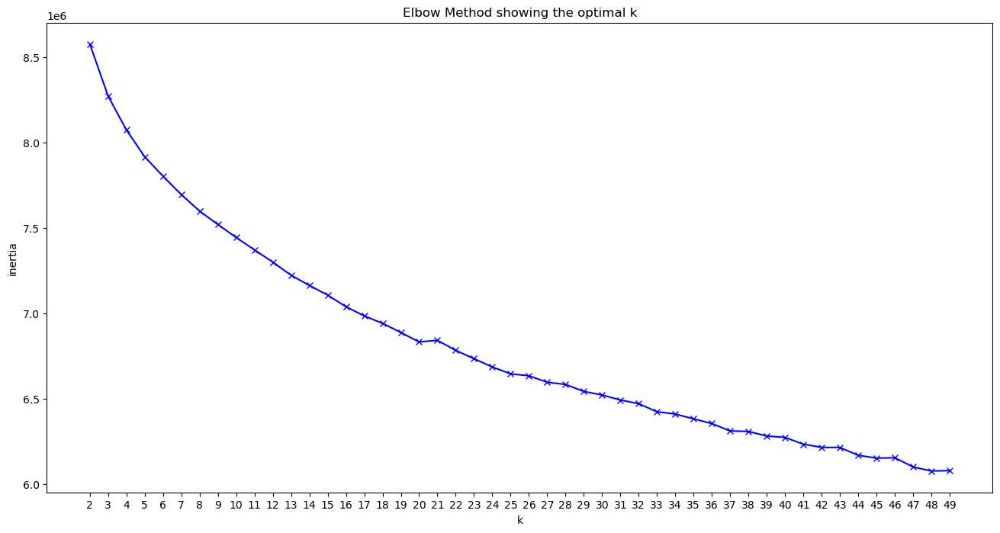

In [128]:
# I am plotting the elbow chart to decide on k
# I put until 50 because I have 49 countries (and around 80 pictures per country)

K = range(2, 50)
inertia = []

for k in K:
    print("Training a K-Means model with {} clusters! ".format(k))
    print()
    kmeans = KMeans(n_clusters=k,
                    random_state=22)
    kmeans.fit(x)
    inertia.append(kmeans.inertia_)

import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

plt.figure(figsize=(16,8))
plt.plot(K, inertia, 'bx-')
plt.xlabel('k')
plt.ylabel('inertia')
plt.xticks(np.arange(min(K), max(K)+1, 1.0))
plt.title('Elbow Method showing the optimal k')

## Defining Kmeans and save as pickle

In [131]:
# Picking 
kmeans20 = KMeans(n_clusters=20, random_state=22)
kmeans20.fit(x)

KMeans(n_clusters=20, random_state=22)

In [132]:
with open("kmeans20.pickle", "wb") as f:
    pickle.dump(kmeans20,f)

In [137]:
kmeans.labels_

array([18,  1, 18, ..., 18,  2, 19])

In [138]:
# get a list of the filenames
filenames = np.array(list(data.keys()))

In [140]:
filenames

array(['10012539.jpg', '10012541.jpg', '10018321.jpg', ..., '9969945.jpg',
       '9976597.jpg', '9979602.jpg'], dtype='<U12')

In [171]:
df = pd.DataFrame({'filename': filenames, 'label': kmeans.labels_})
df.head(10)

,filename,label
0,10012539.jpg,18
1,10012541.jpg,1
2,10018321.jpg,18
3,1002525.jpg,19
4,1002541.jpg,15
5,1003611.jpg,7
6,10039960.jpg,17
7,1004122.jpg,2
8,10045919.jpg,19
9,1007689.jpg,13


## Saving df labels & groups

In [172]:
df.to_csv("labels.csv")

In [180]:
df["label"].value_counts()

18    354
11    339
19    322
5     309
15    271
2     259
9     216
17    205
6     180
3     170
10    165
16    150
7     147
1     145
12    125
13    121
14     92
4      48
0      48
8      16
Name: label, dtype: int64

In [141]:
# holds the cluster id and the images { id: [images] }
groups = {}
for file, cluster in zip(filenames,kmeans.labels_):
    if cluster not in groups.keys():
        groups[cluster] = []
        groups[cluster].append(file)
    else:
        groups[cluster].append(file)

In [148]:
groups

{18: ['10012539.jpg',
  '10018321.jpg',
  '10277617.jpg',
  '10386597.jpg',
  '10482694.jpg',
  '1060803.jpg',
  '1065197.jpg',
  '10868960.jpg',
  '10965032.jpg',
  '10985397.jpg',
  '11056539.jpg',
  '11118689.jpg',
  '1119972.jpg',
  '11261851.jpg',
  '1144240.jpg',
  '1145252.jpg',
  '11477798.jpg',
  '11477799.jpg',
  '11490256.jpg',
  '11536302.jpg',
  '11618609.jpg',
  '11817338.jpg',
  '11844584.jpg',
  '1187911.jpg',
  '11905666.jpg',
  '11917058.jpg',
  '12052403.jpg',
  '12131657.jpg',
  '12133925.jpg',
  '12190329.jpg',
  '12337657.jpg',
  '12376423.jpg',
  '12400517.jpg',
  '1269807.jpg',
  '12814630.jpg',
  '12914491.jpg',
  '12914504.jpg',
  '13025166.jpg',
  '13103543.jpg',
  '13113602.jpg',
  '13193665.jpg',
  '13292437.jpg',
  '13600189.jpg',
  '13688812.jpg',
  '13812183.jpg',
  '13846754.jpg',
  '13920502.jpg',
  '13920558.jpg',
  '13928701.jpg',
  '13965117.jpg',
  '13987508.jpg',
  '14049873.jpg',
  '1422389.jpg',
  '14464338.jpg',
  '1460145.jpg',
  '14607314.jpg

In [181]:
# Saving the scalar
with open("groups.pickle", "wb") as f:
    pickle.dump(groups,f)

In [44]:
# load 
groups = load("groups.pickle")

File not found!


In [45]:
groups

## Clusters' visu

In [18]:
os.chdir(path)

In [19]:
# function that lets you view a cluster (based on identifier)        
def view_cluster(cluster):
    plt.figure(figsize = (25,25));
    # gets the list of filenames for a cluster
    files = groups[cluster]
    # only allow up to 30 images to be shown at a time
    if len(files) > 30:
        print(f"Clipping cluster size from {len(files)} to 30")
        files = files[:29]
    # plot each image in the cluster
    for index, file in enumerate(files):
        plt.subplot(10,10,index+1);
        img = load_img(file)
        img = np.array(img)
        plt.imshow(img)
        plt.axis('off')

Clipping cluster size from 48 to 30


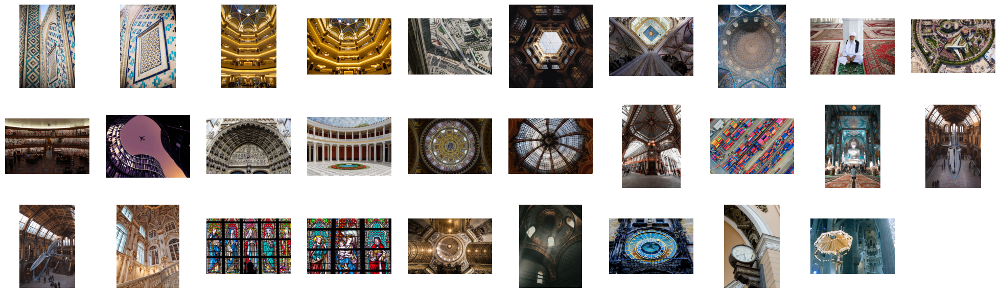

In [20]:
view_cluster(0)

Clipping cluster size from 145 to 30


C:\Users\monkeyluffy14\anaconda3\lib\site-packages\PIL\Image.py:959: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


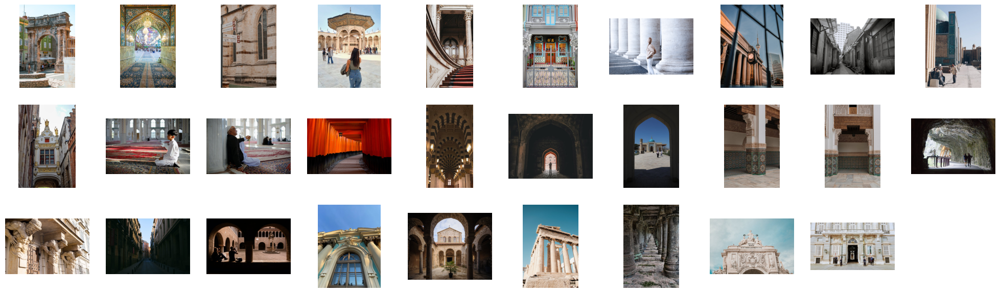

In [21]:
view_cluster(1)

Clipping cluster size from 259 to 30


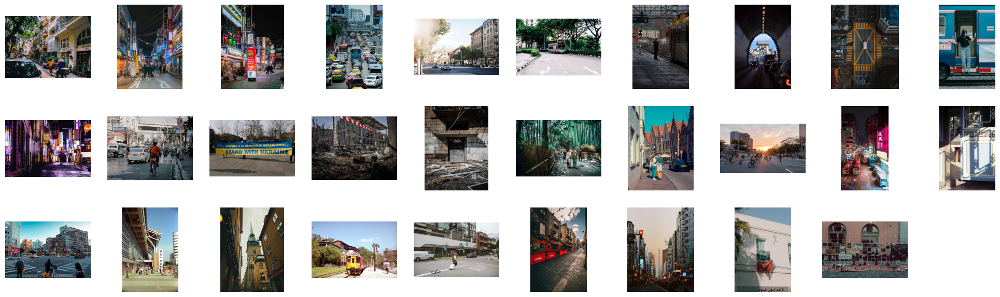

In [22]:
view_cluster(2)

Clipping cluster size from 170 to 30


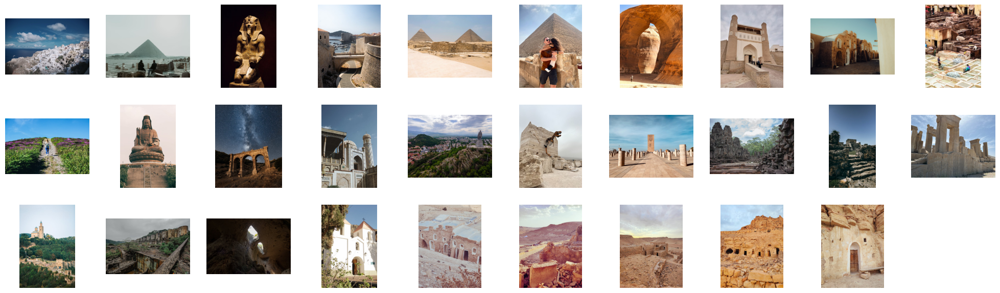

In [23]:
view_cluster(3)

Clipping cluster size from 48 to 30


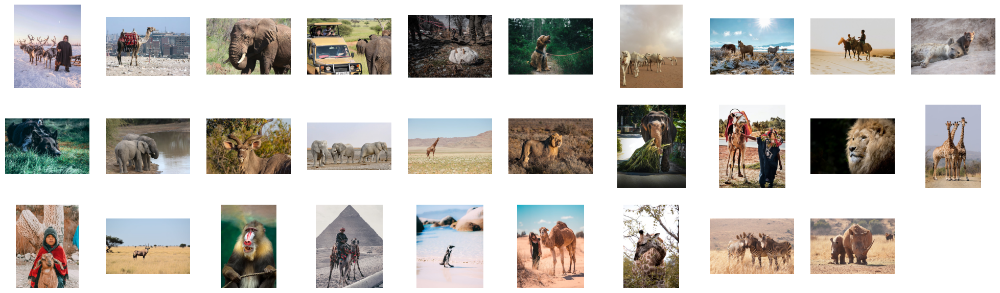

In [24]:
view_cluster(4)

Clipping cluster size from 309 to 30


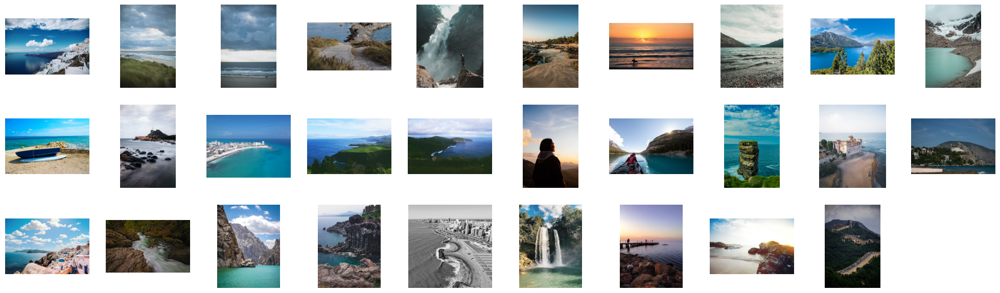

In [25]:
view_cluster(5)

Clipping cluster size from 180 to 30


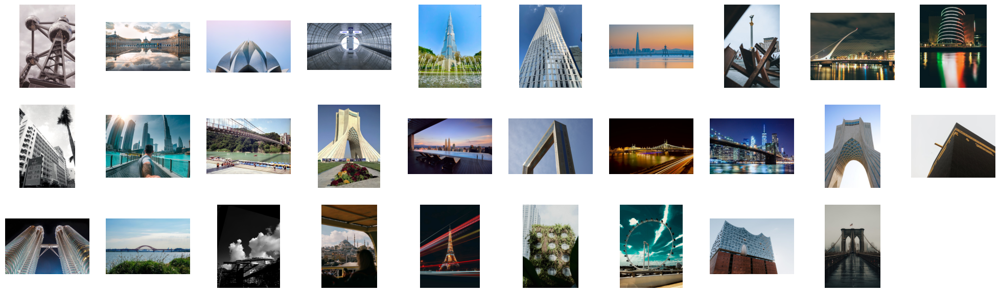

In [26]:
view_cluster(6)

Clipping cluster size from 147 to 30


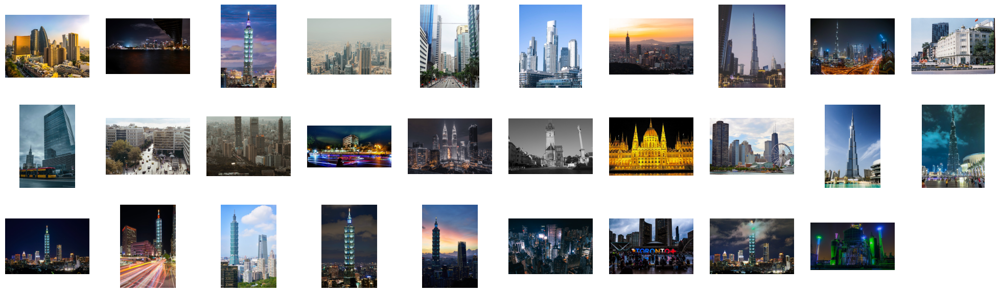

In [27]:
view_cluster(7)

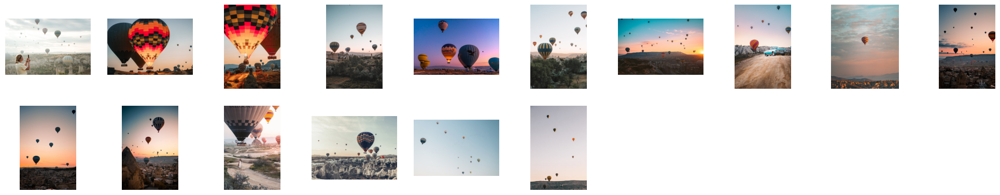

In [28]:
view_cluster(8)

Clipping cluster size from 216 to 30


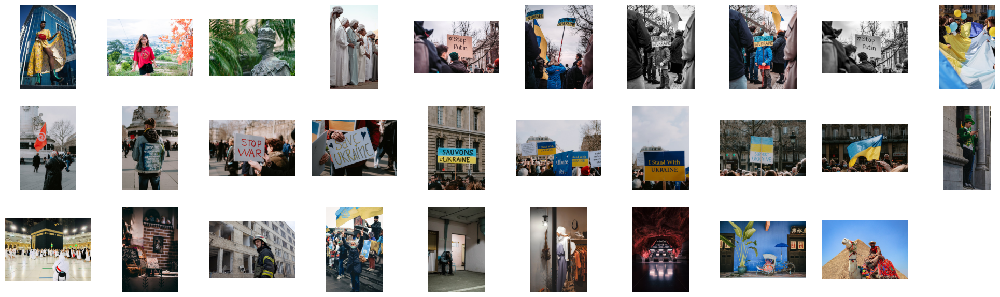

In [29]:
view_cluster(9)

Clipping cluster size from 165 to 30


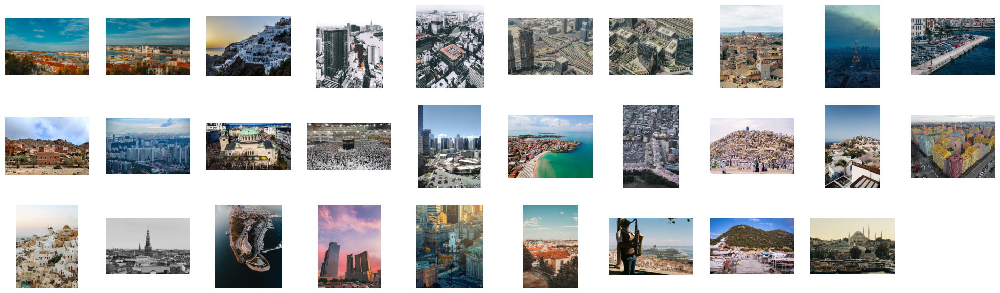

In [30]:
view_cluster(10)

Clipping cluster size from 339 to 30


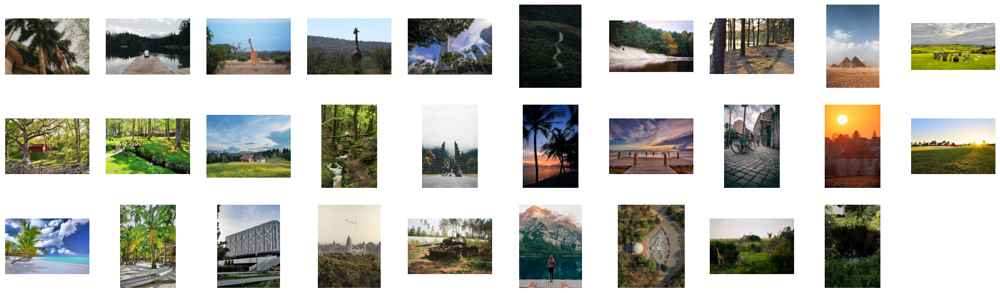

In [31]:
view_cluster(11)

Clipping cluster size from 125 to 30


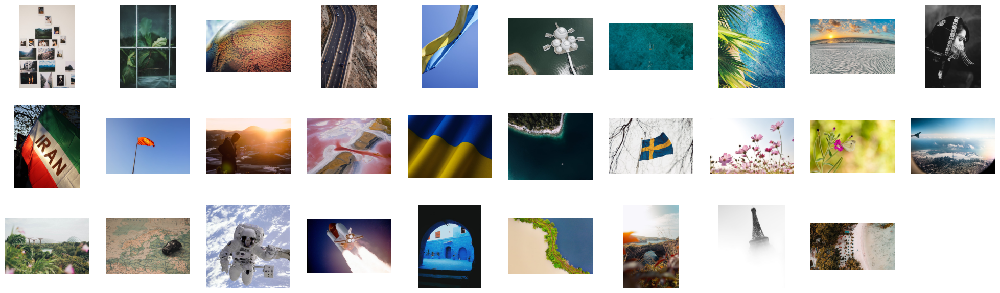

In [32]:
view_cluster(12)

Clipping cluster size from 121 to 30


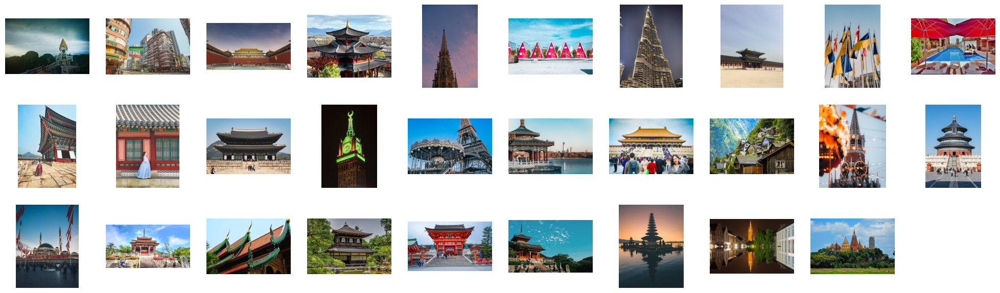

In [33]:
view_cluster(13)

Clipping cluster size from 92 to 30


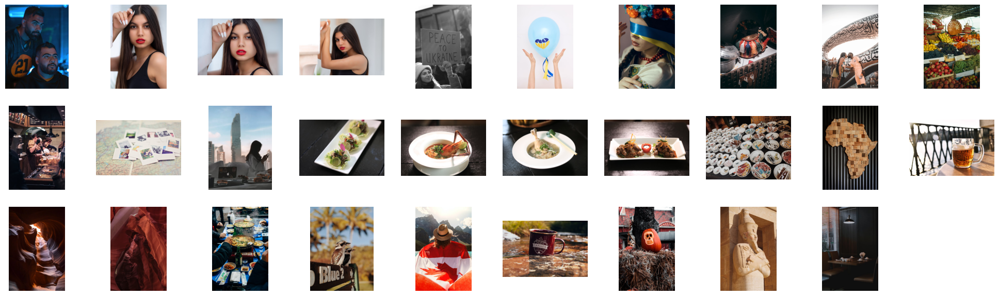

In [34]:
view_cluster(14)

Clipping cluster size from 271 to 30


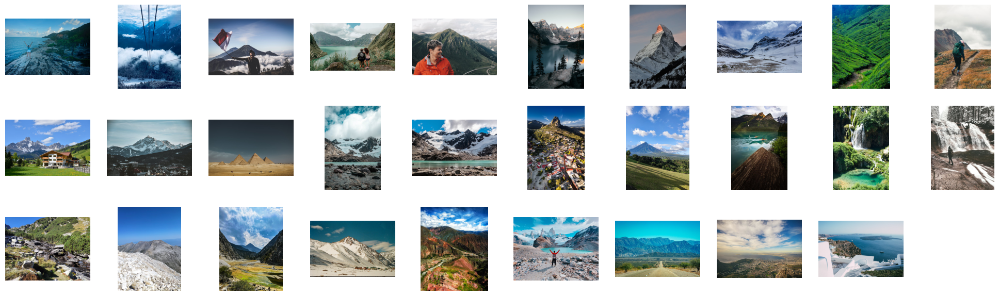

In [35]:
view_cluster(15)

Clipping cluster size from 150 to 30


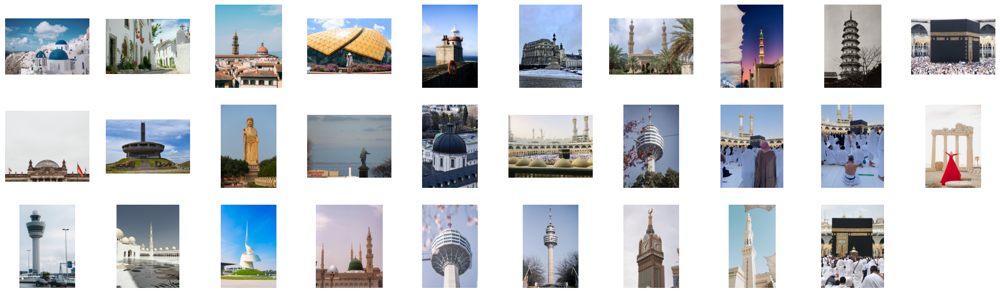

In [36]:
view_cluster(16)

Clipping cluster size from 205 to 30


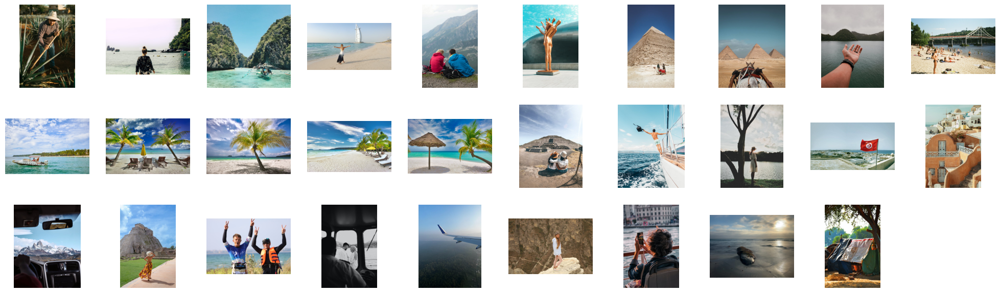

In [37]:
view_cluster(17)

Clipping cluster size from 354 to 30


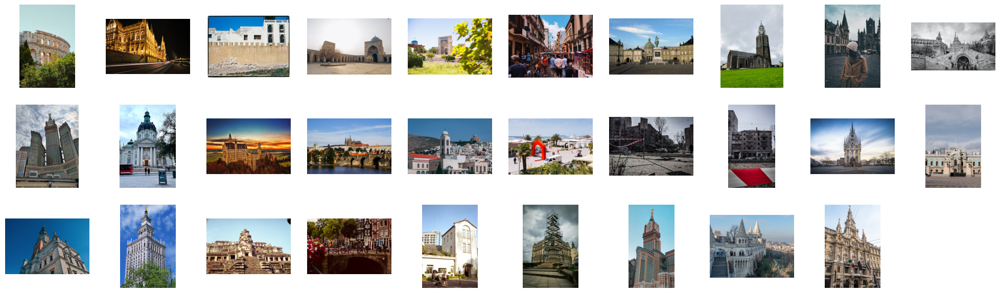

In [38]:
view_cluster(18)

Clipping cluster size from 322 to 30


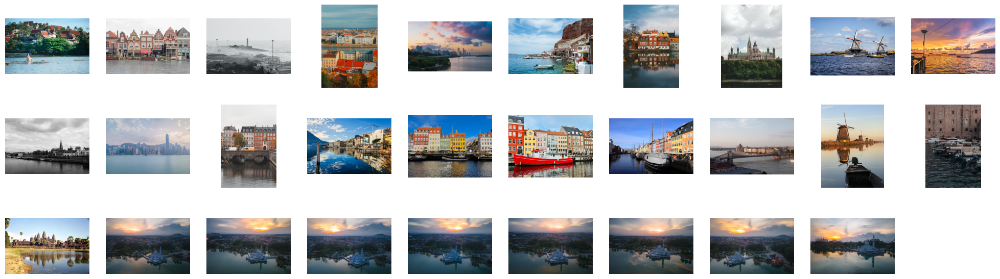

In [39]:
view_cluster(19)

# User experience

In [187]:
df

,filename,label
0,10012539.jpg,18
1,10012541.jpg,1
2,10018321.jpg,18
3,1002525.jpg,19
4,1002541.jpg,15
5,1003611.jpg,7
6,10039960.jpg,17
7,1004122.jpg,2
8,10045919.jpg,19
9,1007689.jpg,13


In [191]:
main_data.head()

,Pictures_id,Width,Height,Full URL,Photographer_id,Description,Country_id,Country_name,region,sub-region,Hex,R,G,B,Photographer
0,13918727,5304,7952,https://www.pexels.com/photo/sculpture-and-streetlight-near-eiffel-tower-in-paris-france-13918727/,5767088,black statue of man on top of building,1,France,Europe,Western Europe,#5E5141,94,81,65,eugenia remark
1,14918481,2000,2500,https://www.pexels.com/photo/photo-of-a-mont-san-michele-abbey-in-france-14918481/,406314056,photo of a mont san michele abbey in france,1,France,Europe,Western Europe,#6C635C,108,99,92,paul jousseau
2,15308877,3629,2433,https://www.pexels.com/photo/concrete-building-view-from-balcony-15308877/,956039,concrete building view from balcony,1,France,Europe,Western Europe,#7B7B79,123,123,121,jill evans
3,14544821,2432,3636,https://www.pexels.com/photo/eiffel-tower-and-seine-14544821/,1245209,eiffel tower and seine,1,France,Europe,Western Europe,#979CA2,151,156,162,polina chistyakova
4,2363,1600,1066,https://www.pexels.com/photo/clear-glass-museum-during-golden-hour-2363/,2659,clear glass museum during golden hour,1,France,Europe,Western Europe,#8E5F38,142,95,56,pixabay


In [200]:
# First, I am going to create a dataframe that will be used later on during the user experience

# Split the filename column and convert to integer
df['Pictures_id'] = df['filename'].str.split('.').str[0].astype(int)

# Join the two dataframes
merged_df = pd.merge(df, main_data[['Pictures_id', 'Description', 'Country_name', 'region', 'sub-region', 'Photographer']], on='Pictures_id')
merged_df.head()

,filename,label,Pictures_id,Description,Country_name,region,sub-region,Photographer
0,10012539.jpg,18,10012539,low angle shot of the pula arena in croatia,Croatia,Europe,Southern Europe,niko pečnik
1,10012541.jpg,1,10012541,ancient gateway in the city,Croatia,Europe,Southern Europe,niko pečnik
2,10018321.jpg,18,10018321,hungary parliament building at night,Hungary,Europe,Eastern Europe,dalia nava
3,1002525.jpg,19,1002525,woman on rock beside body of water,Thailand,Asia,South-eastern Asia,oleksandr pidvalnyi
4,1002541.jpg,15,1002541,woman wearing blue tank top standing beside body of water,Thailand,Asia,South-eastern Asia,oleksandr pidvalnyi


In [201]:
merged_df.shape

(3682, 8)

In [294]:
merged_df.to_csv("merged_df.csv")

## Scenario 1: Visually Similar Pictures Recommender (for travel industry)

In [121]:
merged_df = pd.read_csv("C:/Users/monkeyluffy14/Desktop/Final Project/merged_df.csv")

Enter a region from the following options: Europe, Asia, Americas, Africa, Oceania
Europe
Available countries in Europe are: Croatia, Hungary, Belgium, Austria, Greece, Portugal, Netherlands, Ukraine, Switzerland, Denmark, Sweden, Russia, Italy, France, Poland, Ireland, Germany, Czech Republic, Bulgaria, Spain, United Kingdom
Enter a country from the available options: Italy


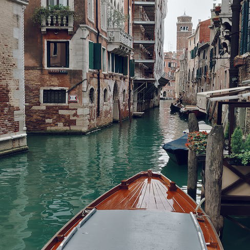

Description: brown boat along the canals of venice
Photographer: dids




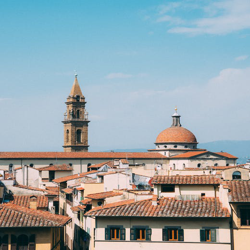

Description: concrete dome building under blue sky
Photographer: kai pilger




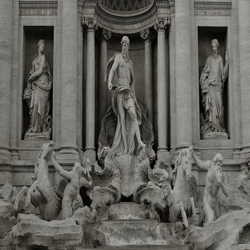

Description: grayscale photo of sculptures
Photographer: axel grollemund




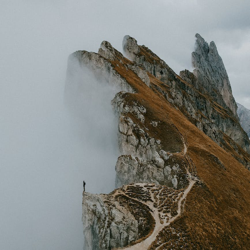

Description: photo of person standing on cliff edge
Photographer: tom verdoot




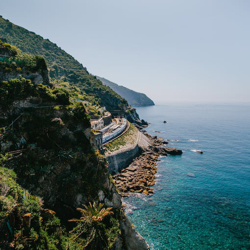

Description: mountain beside body of water
Photographer: josh hild


Enter the number of the picture you like (1-5): 1


In [186]:
path = r"C:/Users/monkeyluffy14/Desktop/Final Project/images"
os.chdir(path)

# create a list of regions
regions = merged_df['region'].unique()

# prompt the user to input a region and display all available countries in that region
while True:
    user_region = input("Enter a region from the following options: {}\n".format(", ".join(regions)))
    if user_region in regions:
        break
    else:
        print("Invalid input. Please enter a valid region.")

available_countries = merged_df.loc[merged_df['region']==user_region, 'Country_name'].unique()
print("Available countries in {} are: {}".format(user_region, ", ".join(available_countries)))

# prompt the user to select a country
while True:
    user_country = input("Enter a country from the available options: ")
    if user_country in available_countries:
        break
    else:
        print("Invalid input. Please enter a valid country.")
        
# select 5 random pictures from the selected country
country_df = merged_df.loc[merged_df['Country_name']==user_country, :]
random_5 = country_df.sample(n=5,random_state=42)

# display the images with their description and photographer
from PIL import Image

for index, row in random_5.iterrows():
    file_path = row['filename']
    img = Image.open(file_path)
    img = img.resize((250, 250))
    display(img)
    print("Description: {}".format(row['Description']))
    print("Photographer: {}".format(row['Photographer']))
    print("\n")

# prompt the user to select the images they like
user_selection = []
while True:
    pic_number = input("Enter the number of the picture you like (1-5): ")
    if pic_number.isdigit() and int(pic_number) in range(1, 6):
        user_selection.append(random_5.iloc[int(pic_number)-1]['filename'])
        break
    print("Invalid input, please try again.\n")
    
selected_image = merged_df.loc[merged_df['filename'] == user_selection[0]]
selected_label = selected_image['label'].iloc[0]



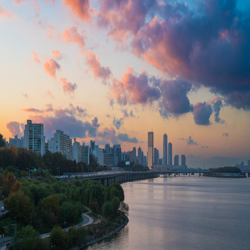

Description: drone shot of the han river
Photographer: ethan brooke
Country: South Korea




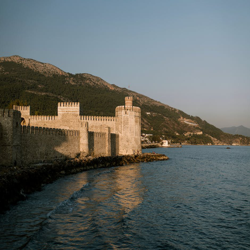

Description: medieval fortress on seashore against grassy hill
Photographer: julia volk
Country: Turkey




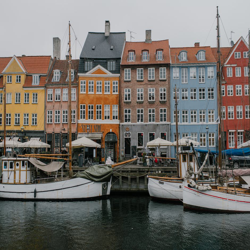

Description: buildings by the water 
Photographer: julia volk
Country: Denmark




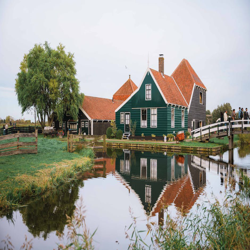

Description: farmhouse by the pond in de zaanse schans, netherlands
Photographer: ali  alcantara
Country: Netherlands




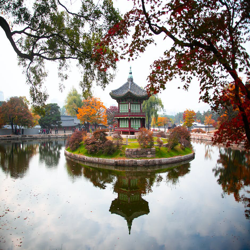

Description: palace in the middle of a pond
Photographer: 김 대정
Country: South Korea


Do you like our recommended selection? (y/n): y


In [187]:
while True:
    # retrieve the cluster/label of the user's selected image
    selected_image_label = merged_df.loc[merged_df['filename']==user_selection[0], 'label'].values[0]

    # retrieve all images with the same cluster/label but a different country
    similar_images = merged_df.loc[(merged_df['label']==selected_image_label) & (merged_df['Country_name']!=user_country)]

    # randomly select 5 images from the similar images
    random_5_similar = similar_images.sample(n=5)

    # display the similar images with their description and photographer
    for index, row in random_5_similar.iterrows():
        file_path = row['filename']
        img = Image.open(file_path)
        img = img.resize((250, 250))
        display(img)
        print("Description: {}".format(row['Description']))
        print("Photographer: {}".format(row['Photographer']))
        print("Country: {}".format(row['Country_name']))
        print("\n")

    # ask if the user likes the selection
    user_likes = input("Do you like our recommended selection? (y/n): ")
    if user_likes.lower() == 'y':
        break
    elif user_likes.lower() == 'n':
        continue
    else:
        print("Invalid input, please try again.\n")
        continue

## Scenario 2: Testing on unknown pictures

In [207]:
# setting path to test images folder
path_test = r"C:/Users/monkeyluffy14/Desktop/Final Project/images_test"

# change the working directory to the path where the images are located
os.chdir(path_test)

# this list holds all the image filename
test_pictures = []

# creates a ScandirIterator aliased as files
with os.scandir(path_test) as files:
  # loops through each file in the directory
    for file in files:
        if file.name.endswith('.jpg'):
          # adds only the image files to the pictures list
            test_pictures.append(file.name)

test_data = {}

# lop through each image in the dataset
# pictures have been defined before as a list of all my pictures'name/title
for test_picture in test_pictures:
    # try to extract the features and update the dictionary
    try:
        features = extract_features(test_picture,model)
        test_data[test_picture] = features
    # if something fails, save the extracted features as a pickle file (optional)
    except:
        with open("test_data.pickle",'wb') as file:
            pickle.dump(test_data,file)

list_features = np.array(list(test_data.values()))
feat_test = list_features.reshape(-1,4096)

# scaler, pca and kmeans loading
scaler = load("C:/Users/monkeyluffy14/Desktop/Final Project/scaler.pickle")
scaled_feat_test = scaler.transform(feat_test)

# reducing to 120 dim
pca = load("C:/Users/monkeyluffy14/Desktop/Final Project/pca_model.pkl")
x_test = pca.transform(scaled_feat_test)

kmeans_model = load("C:/Users/monkeyluffy14/Desktop/Final Project/kmeans20.pickle")
test_cluster = kmeans_model.predict(x_test)
test_cluster

1/1 [==============================] - 0s 210ms/step


array([15,  6, 15,  4, 11])

In [208]:
# get a list of the filenames
test_filenames = np.array(list(test_data.keys()))
test_filenames

array(['Angela.jpg', 'Berkay.jpg', 'Kaci.jpg', 'Katerina.jpg', 'Yen.jpg'],
      dtype='<U12')

In [209]:
test_cluster

array([15,  6, 15,  4, 11])

In [210]:
test_df = pd.DataFrame({'test_filename': test_filenames, 'label': test_cluster})
test_df

,test_filename,label
0,Angela.jpg,15
1,Berkay.jpg,6
2,Kaci.jpg,15
3,Katerina.jpg,4
4,Yen.jpg,11


In [211]:
test_df["filename"] = test_df["test_filename"].str.split('.').str[0]

In [212]:
test_df

,test_filename,label,filename
0,Angela.jpg,15,Angela
1,Berkay.jpg,6,Berkay
2,Kaci.jpg,15,Kaci
3,Katerina.jpg,4,Katerina
4,Yen.jpg,11,Yen


Enter a filename from the following options: Angela, Berkay, Kaci, Katerina, Yen
Angela
Description: It's a secret, but probably Colombia


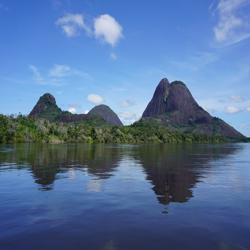

In [216]:
# setting path to test images folder
path_test = r"C:/Users/monkeyluffy14/Desktop/Final Project/images_test"

# change the working directory to the path where the images are located
os.chdir(path_test)

# prompt the user to choose a filename and display the image
while True:
    user_filename = input("Enter a filename from the following options: {}\n".format(", ".join(test_df['filename'].unique())))
    if user_filename in test_df['filename'].unique():
        break
    else:
        print("Invalid input. Please enter a valid filename.")

# display the selected image
if user_filename == "Kaci":
    print("Description: {}".format("city of Djanet in Southern Algeria"))
elif user_filename == "Katerina":
    print("Description: {}".format("Altai, in Russia"))
elif user_filename == "Angela":
    print("Description: {}".format("It's a secret, but probably Colombia"))
elif user_filename == "Berkay":
    print("Description: {}".format("Love from Turkey"))
else:
    print("Description: {}".format("Rice field from the internet, my dream"))
file_path = os.path.join(path_test, user_filename+".jpg")
img = Image.open(file_path)
img = img.resize((250, 250))
display(img)


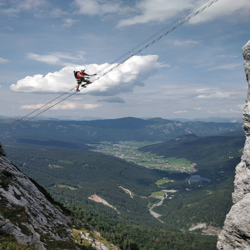

Description: man climbing the sky ladder on the way to the peak of donnerkogel mountain
Photographer: gunther z
Country: Austria




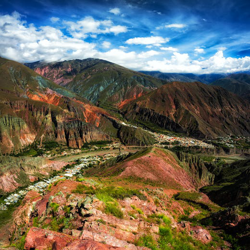

Description: the mountain province of iruya salta in argentina
Photographer: agustin devani
Country: Argentina




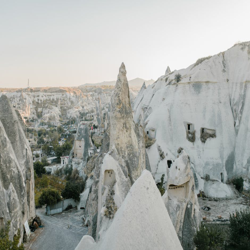

Description: amazing view of famous cappadocia highlands with white rocky formations beneath clear blue sky
Photographer: julia volk
Country: Turkey




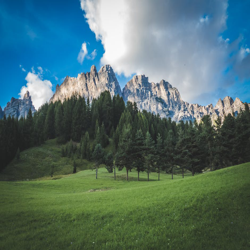

Description: green field and trees
Photographer: mauricio artieda
Country: Italy




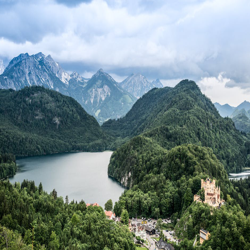

Description: green mountains near river under blue sky
Photographer: wiriyah ruechaipanit
Country: Germany




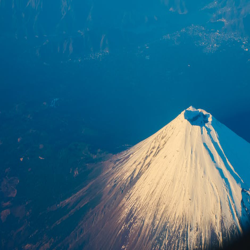

Description: mountain covered by snow
Photographer: tirachard kumtanom
Country: Japan




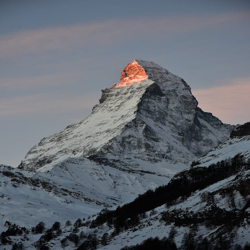

Description: scenic view of matterhorn, switzerland 
Photographer: timo niedermann
Country: Switzerland




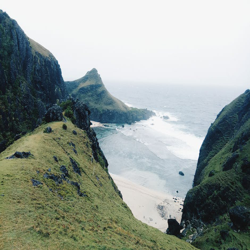

Description: green mountain ruins near seashore
Photographer: christian paul del rosario
Country: Philippines




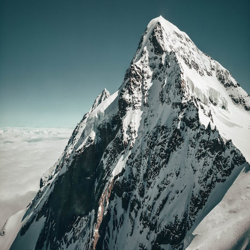

Description: aerial photography of mountain alps
Photographer: joan costa
Country: Switzerland




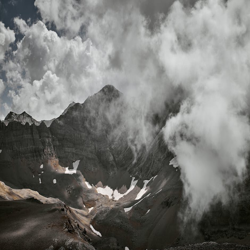

Description: white clouds over mountains
Photographer: selman arif golbasi
Country: Kyrgyzstan




In [217]:
# setting path to test images folder
path= r"C:/Users/monkeyluffy14/Desktop/Final Project/images"

# change the working directory to the path where the images are located
os.chdir(path)

# get the label of the selected picture
selected_label = test_df.loc[test_df['filename'] == user_filename, 'label'].iloc[0]

# retrieve all images with the same cluster/label but a different country
similar_images = merged_df.loc[(merged_df['label']==selected_label)]

# randomly select 10 images from the similar images
random_10_similar = similar_images.sample(n=10)

# display the similar images with their description and photographer
for index, row in random_10_similar.iterrows():
    file_path = row['filename']
    img = Image.open(file_path)
    img = img.resize((250, 250))
    display(img)
    print("Description: {}".format(row['Description']))
    print("Photographer: {}".format(row['Photographer']))
    print("Country: {}".format(row['Country_name']))
    print("\n")